<a href="https://colab.research.google.com/github/MrAwesomeJr/comp-451-cat-bounding-box/blob/main/iterative_version.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install fiftyone

In [3]:
!ls /content

fasterrcnn_epoch_1.pth	sample_data


In [5]:
from google.colab import files
files.download("/content/fasterrcnn_epoch_1.pth")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [1]:
import fiftyone as fo
import numpy as np

dataset = fo.zoo.load_zoo_dataset(
              "open-images-v7",
              split="train",
              label_types=["detections"],
              classes=["Cat"],
          )

INFO:fiftyone.zoo.datasets:Downloading split 'train' to '/root/fiftyone/open-images-v7/train' if necessary


Necessary images already downloaded


INFO:fiftyone.utils.openimages:Necessary images already downloaded


Existing download of split 'train' is sufficient


INFO:fiftyone.zoo.datasets:Existing download of split 'train' is sufficient


Loading existing dataset 'open-images-v7-train'. To reload from disk, either delete the existing dataset or provide a custom `dataset_name` to use


INFO:fiftyone.zoo.datasets:Loading existing dataset 'open-images-v7-train'. To reload from disk, either delete the existing dataset or provide a custom `dataset_name` to use


In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torch.optim as optim
import torchvision.transforms as transforms
import cv2

In [3]:
# try fewer samples
# n_samples = len(dataset)
n_samples = 300

x_size = 267
y_size = 326

In [4]:
batch_size = 5
# (267 x 326) is the number of pixels in the smallest images

batched_data = torch.zeros([n_samples// batch_size, batch_size, 3, y_size, x_size], dtype=torch.float32)
# batched_boxes = np.ndarray((n_samples // batch_size, batch_size, 4))
batched_targets = []

for batch_index in range(n_samples // batch_size):
    for i, sample in enumerate(dataset[batch_index * batch_size:(batch_index + 1) * batch_size]):
        batched_data[batch_index, i] = torch.from_numpy(cv2.resize(cv2.imread(sample['filepath']), (x_size, y_size)).transpose(2, 0, 1))
        batched_targets.append([])
        for detection in sample['ground_truth']['detections']:
                box = detection['bounding_box']

                x_min, y_min, width, height = box
                x_max = x_min + width
                y_max = y_min + height
                target = {
                    'boxes': torch.tensor([[x_min * x_size, y_min * y_size, x_max * x_size, y_max * y_size]], dtype=torch.float32),
                    'labels': torch.tensor([1 if detection['label'] == 'Cat' else 0], dtype=torch.int64),  # Assuming 1 is the label for 'Cat'
                }
                batched_targets[batch_index].append(target)


In [5]:
# using documentation from https://pytorch.org/vision/stable/models/generated/torchvision.models.detection.fasterrcnn_resnet50_fpn.html#torchvision.models.detection.fasterrcnn_resnet50_fpn
from sklearn.metrics import average_precision_score
import ssl
ssl._create_default_https_context = ssl._create_unverified_context

model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights=None, num_classes=2)
model.load_state_dict(torch.load("fasterrcnn_epoch_1.pth"))
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
model.to(device)

optimizer = torch.optim.SGD(model.parameters(), lr=0.001, momentum=0.9, weight_decay=0.0005)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)

num_batches = len(batched_data)  # Total number of batches
num_epochs = 1  # Number of training epochs

model.train()
for epoch in range(num_epochs):
    model.train()  # Set model to training mode
    epoch_loss = 0

    print(f"Epoch {epoch + 1}/{num_epochs}")
    for batch_index in range(num_batches):
        # Move the current batch of data and targets to the device
        images = batched_data[batch_index].to(device)
        targets = [{k: v.to(device) for k, v in target.items()} for target in batched_targets[batch_index]]

        # Forward pass
        loss_dict = model(list(images), targets)
        total_loss = sum(loss for loss in loss_dict.values())

        # Backward pass
        optimizer.zero_grad()
        total_loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=2.0) # previent gradient exploding
        optimizer.step()

        # Accumulate batch loss
        epoch_loss += total_loss.item()

        print(f"  Batch {batch_index + 1}/{num_batches} - Loss: {total_loss.item():.4f}")

    # Adjust learning rate
    lr_scheduler.step()


    # Save model checkpoint
    torch.save(model.state_dict(), f"fasterrcnn_epoch_{epoch + 1}.pth")



Epoch 1/1
  Batch 1/20 - Loss: 10.2427
  Batch 2/20 - Loss: 7.8210
  Batch 3/20 - Loss: 6.3783
  Batch 4/20 - Loss: 1.9564
  Batch 5/20 - Loss: 2.7393
  Batch 6/20 - Loss: 1.6399
  Batch 7/20 - Loss: 2.2014
  Batch 8/20 - Loss: 2.0265
  Batch 9/20 - Loss: 1.5096
  Batch 10/20 - Loss: 1.3335
  Batch 11/20 - Loss: 1.0384
  Batch 12/20 - Loss: 0.6969
  Batch 13/20 - Loss: 1.0373
  Batch 14/20 - Loss: 1.0218
  Batch 15/20 - Loss: 0.6561
  Batch 16/20 - Loss: 0.7765
  Batch 17/20 - Loss: 1.6097
  Batch 18/20 - Loss: 1.0543
  Batch 19/20 - Loss: 1.1562
  Batch 20/20 - Loss: 0.6498


In [6]:
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights=None, num_classes=2)
model.load_state_dict(torch.load("fasterrcnn_epoch_1.pth"))

<ipython-input-6-9cbf428f3dba>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("fasterrcnn_epoch_1.pth"))


<All keys matched successfully>

In [7]:
model.eval()
#print(output)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=1e-05)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=1e-05)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=1e-05)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=1e-05)
          (relu

In [8]:
import fiftyone as fo
import numpy as np

test_set = fo.zoo.load_zoo_dataset(
              "open-images-v7",
              split="test",
              label_types=["detections"],
              classes=["Cat"],
            #   max_samples=10,
          )

test_samples = 100

test_data = torch.zeros([test_samples, 3, y_size, x_size], dtype=torch.float32)
test_targets = []
for i, sample in enumerate(dataset[:test_samples]):
    test_data[i] = torch.from_numpy(cv2.resize(cv2.imread(sample['filepath']), (x_size, y_size)).transpose(2, 0, 1))

    boxes = []
    labels = []
    for detection in sample['ground_truth']['detections']:
        box = detection['bounding_box']

        x_min, y_min, width, height = box
        x_max = x_min + width
        y_max = y_min + height
        boxes.append([x_min * x_size, y_min * y_size, x_max * x_size, y_max * y_size])
        labels.append(1 if detection['label'] == 'Cat' else 0)  # Assuming 1 is the label for 'Cat'
    target = {
        'boxes': torch.tensor(boxes, dtype=torch.float32),
        'labels': torch.tensor(labels, dtype=torch.int64),
    }
    test_targets.append(target)

INFO:fiftyone.zoo.datasets:Downloading split 'test' to '/root/fiftyone/open-images-v7/test' if necessary


Necessary images already downloaded


INFO:fiftyone.utils.openimages:Necessary images already downloaded


Existing download of split 'test' is sufficient


INFO:fiftyone.zoo.datasets:Existing download of split 'test' is sufficient


Loading existing dataset 'open-images-v7-test'. To reload from disk, either delete the existing dataset or provide a custom `dataset_name` to use


INFO:fiftyone.zoo.datasets:Loading existing dataset 'open-images-v7-test'. To reload from disk, either delete the existing dataset or provide a custom `dataset_name` to use


In [10]:
batch_size = 20  #processing in batches of 20 images at a time
predictions = []

for i in range(0, len(test_data), batch_size):
    batch = test_data[i:i + batch_size]
    print(i)
    # Run inference on the batch
    with torch.no_grad():
        predictions_batch = model(batch)

    predictions.extend(predictions_batch)

0
20
40
60
80


In [ ]:
predictions = model(test_data)
confidence_threshold = 0.7  # Adjust this as needed
filtered_predictions = []
for pred in predictions:
    high_conf_indices = pred['scores'] > confidence_threshold
    filtered_predictions.append({
        'boxes': pred['boxes'][high_conf_indices],
        'labels': pred['labels'][high_conf_indices],
        'scores': pred['scores'][high_conf_indices],
    })
#print(predictions)

0 14
1 50
2 3
3 84
4 2
5 2
6 86
7 4
8 4
9 3
10 1
11 0
12 100
13 6


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.10/dist-packages/torchvision/utils.py:211: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


14 2
15 61
16 18
17 9
18 6
19 8
20 3
21 100
22 4
23 100
24 39
25 44
26 1
27 56
28 0
29 9
30 100
31 0
32 15
33 7
34 6
35 10
36 3
37 0
38 67
39 2
40 5
41 3
42 50
43 8
44 10
45 14
46 3
47 4
48 4
49 1
50 34
51 14
52 0
53 4
54 100
55 2
56 100
57 14
58 63
59 32
60 0
61 0
62 5
63 5
64 100
65 11
66 100
67 37
68 4
69 10
70 9
71 5
72 100
73 2
74 46
75 4
76 1
77 45
78 1
79 24
80 6
81 9
82 12
83 4
84 68
85 13
86 100
87 52
88 0
89 9
90 61
91 6
92 99
93 0
94 3
95 8
96 3
97 3
98 9
Average Precision (AP): 0.4225
F1 score: 0.6154


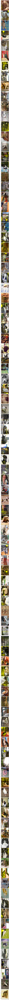

In [15]:
# from https://pytorch.org/tutorials/intermediate/torchvision_tutorial.html

import matplotlib.pyplot as plt
%matplotlib inline
from torchvision.utils import draw_bounding_boxes
from mpl_toolkits.axes_grid1 import ImageGrid
from sklearn.metrics import f1_score, average_precision_score
import torch
import numpy as np
import math
y_true = []
y_pred = []
y_scores = []

num_plots = 99
fig = plt.figure(figsize=(num_plots, 4.*num_plots*y_size/x_size))
grid = ImageGrid(fig, 111, nrows_ncols=(num_plots, 1), axes_pad=0.1)

for i in range(num_plots):
  image_index = i

  y_true.extend(test_targets[image_index]['labels'].cpu().numpy())

  predicted_labels = predictions[image_index]['labels'].cpu().numpy()
  y_pred.extend(predicted_labels)
  predicted_scores = predictions[image_index]['scores'].detach().cpu().numpy()

  mean_pscore=np.mean(predicted_scores)
  if math.isnan(mean_pscore):
    mean_pscore=0

  y_scores.append(mean_pscore)

  label_strings = []
  for label in test_targets[image_index]['labels']:
      label_strings.append("Cat" if label == 1 else "Background")
  prediction_label_strings = []
  for j, label in enumerate(predictions[image_index]['labels']):
      prediction_label_strings.append(f"Cat: {predictions[image_index]['scores'][j]:0.2f}" if label == 1 else "Background")
  print(i,len(prediction_label_strings))
  output_image = draw_bounding_boxes(test_data[image_index].to(torch.uint8).flip(0), test_targets[image_index]['boxes'], label_strings, colors="red")
  output_image = draw_bounding_boxes(output_image, predictions[image_index]['boxes'], prediction_label_strings, colors="yellow")
  grid[i].imshow(output_image.permute(1, 2, 0))


ap = average_precision_score(y_true[:100], y_scores)
print(f"Average Precision (AP): {ap:.4f}")
f1 = f1_score(y_true[:100], y_pred[:100])
print(f"F1 score: {f1:.4f}")

In [ ]:
import datetime
print(datetime.datetime.now())
torch.save(model.state_dict(), f"./model_{batch_size}_{datetime.datetime.now()}")

2024-12-12 18:31:10.565052
